In [1]:
from flows import api, load_config

In [2]:
config = load_config()

In [3]:
c = api.get_catalog(1349)

In [12]:
c2 = api.get_catalog(1374)
c = c2

In [13]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from astropy.table import Table
import astropy.units as u
from astropy.coordinates import SkyCoord
import seaborn as sns
%matplotlib inline
sns.set()

ref = c['references']
tar = c['target']


ra_tar = tar['ra'].data[0]
dec_tar = tar['decl'].data[0]


def get_corners(ra,dec,radius):
    corners=[(ra-radius,dec-radius),(ra-radius,dec+radius),
            (ra+radius,dec+radius),(ra+radius,dec-radius)]
    #print(corners)
    return corners

def process_corner(corners):
    _points=[]
    for corner in corners:
        _points.append(u.quantity.Quantity(corner))
    corners_p=np.array(_points)
    return corners_p

def default_point_chip1(ra,dec,chip1_center):
    return ra+chip1_center,dec-chip1_center


chip1_center=3.75*u.arcmin+15*u.arcsecond #This is the distance to Chip 1 center from Field center.
field_hw=7.5*u.arcminute #full field height width
chip1_hw=3.5*u.arcminute #chip1 field height width

#Get default pointing roughly centered at chip1 center.
ra,dec=default_point_chip1(ra_tar*u.deg,dec_tar*u.deg,chip1_center)

#Get corners of Chip 1 and full-field centered, where full field is centered at ra,dec.
corners=get_corners(ra,dec, field_hw)
chip1=get_corners(ra-chip1_center,
                  dec+chip1_center, chip1_hw)

#Process to be easily plottable
chip1=process_corner(chip1)
corners=process_corner(corners)

In [14]:
from astropy.coordinates import SkyCoord
from astropy.wcs import WCS

coords = SkyCoord(ref['ra'],ref['decl'])

wcs = WCS(dict(
    ctype1 = "RA---TAN",
    ctype2 = "DEC--TAN",
    crval1 = ra_tar, # R.A. center
    crval2 = dec_tar, # Dec. center
), naxis=2)

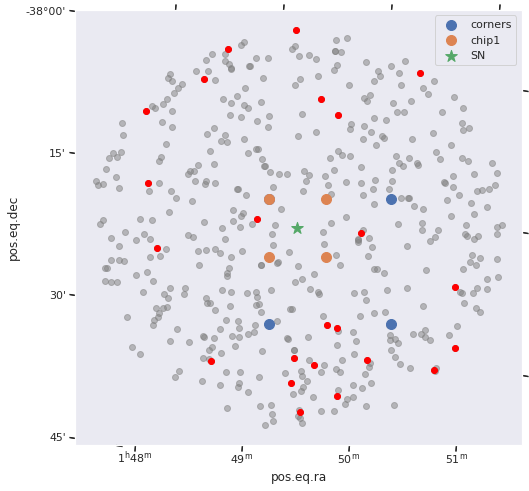

In [15]:
sns.set_theme(style='dark')
fig, ax = plt.subplots(figsize=(8,8),subplot_kw={'projection':wcs})
ax.scatter(ref['ra'],ref['decl'],color='grey',alpha=0.5)
mask = ref['H_mag'] <= 12.0
ax.scatter(ref['ra'][mask],ref['decl'][mask],color='red',zorder=5)
ax.scatter(corners[:,0]*u.deg,corners[:,1]*u.deg,label='corners',s=100)
ax.scatter(chip1[:,0]*u.deg,chip1[:,1]*u.deg,label='chip1',s=100)
ax.scatter(ra_tar,dec_tar,marker='*',s=150,label='SN')
ax.legend()
#ax.show()

In [16]:
from shapely.geometry import Polygon
from shapely.geometry import Point
from shapely.geometry import asMultiPoint
from shapely.geometry import MultiPoint

corner_poly = Polygon(corners)
sn = Point(ra_tar,dec_tar)
#ints = refs.intersection(corner_poly)

In [17]:
ref['Shapely'] = list(MultiPoint(list(zip(ref['ra'],ref['decl']))))

In [18]:
ref['pointed'] = [corner_poly.contains(r['Shapely']) for r in ref]

In [19]:
ref[ref['pointed']]['H_mag'].min()

11.818

In [20]:
import astropy.units as u
ra_q = tar['ra'].data[0] * u.deg
dec_q = tar['decl'].data[0] * u.deg

In [21]:
#transform=ax.get_transform('fk5')
#plt.gca().get_transform('fk5')

In [22]:
from astropy.wcs import WCS
from astropy.io import fits

In [23]:
from astroquery.skyview import SkyView

In [24]:
#SkyView.list_surveys()
#IR:2MASS': ['2MASS-J', '2MASS-H', '2MASS-K']

In [25]:
out = SkyView.get_images(position='{}, {}'.format(tar['ra'].data[0],tar['decl'].data[0]),
                   survey='2MASS-H', pixels='2500',
                   coordinates='J2000', scaling='Linear', radius=50*u.arcmin)

In [27]:
out

[[<astropy.io.fits.hdu.image.PrimaryHDU object at 0x7f8702e669d0>]]

In [26]:
image = out[0][0]
image.header

SIMPLE  =                    T / Written by SkyView Tue Sep 14 09:55:21 EDT 2021
BITPIX  =                  -32 / 4 byte floating point                          
NAXIS   =                    2 / Two dimensional image                          
NAXIS1  =                 2500 / Width of image                                 
NAXIS2  =                 2500 / Height of image                                
CRVAL1  =              11.9123 / Reference longitude                            
CRVAL2  =             -20.5235 / Reference latitude                             
RADESYS = 'FK5     '           / Coordinate system                              
EQUINOX =               2000.0 / Epoch of the equinox                           
CTYPE1  = 'RA---TAN'           / Coordinates -- projection                      
CTYPE2  = 'DEC--TAN'           / Coordinates -- projection                      
CRPIX1  =               1250.5 / X reference pixel                              
CRPIX2  =               1250

In [27]:
wcs_H = WCS(image.header)

In [28]:
from flows.plots import plot_image

In [29]:
ref_pix = wcs_H.all_world2pix(ref['ra'],ref['decl'],0)

In [30]:
np.min(image.data.flat), np.max(image.data.flat), np.median(image.data.flat), np.mean(image.data.flat), np.std(image.data.flat)

(436.84793, 8965.692, 444.17786, 444.29788, 15.069824)

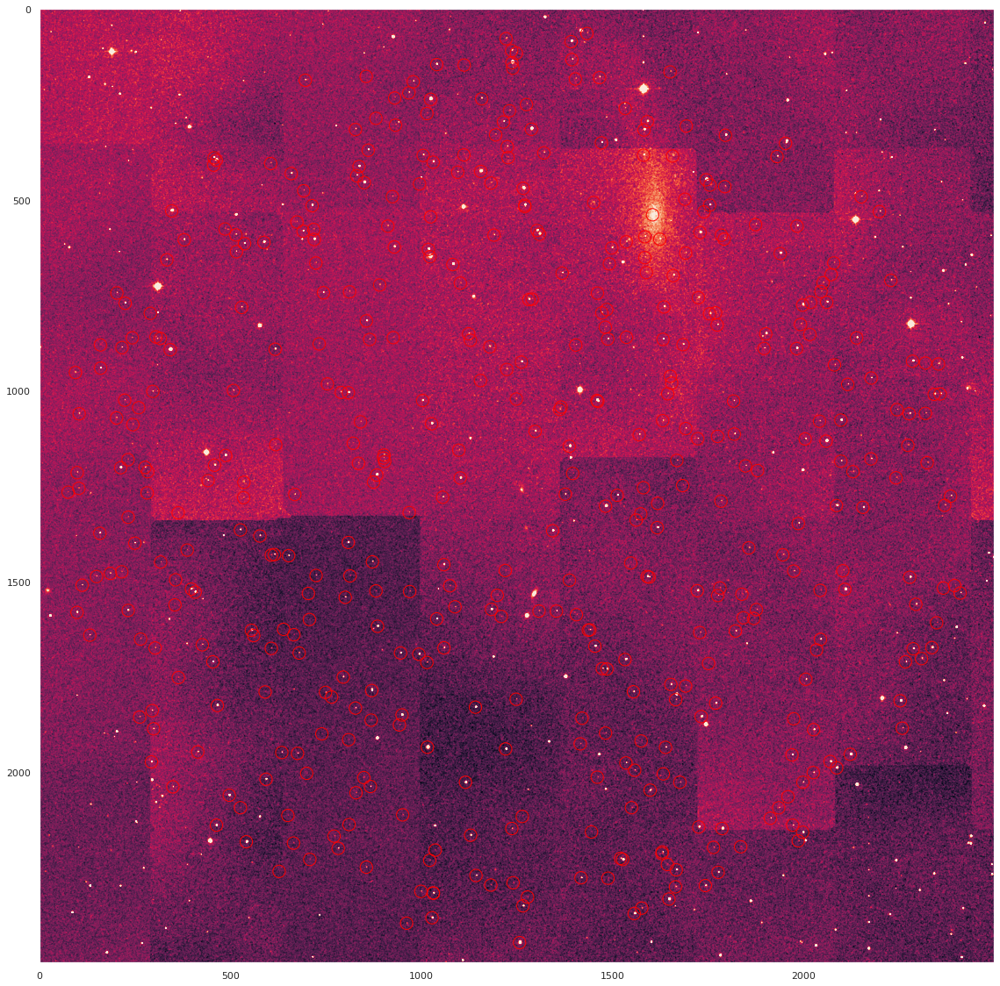

In [36]:
from astropy.visualization import ZScaleInterval
zscale = ZScaleInterval()
vmin,vmax = zscale.get_limits(image.data.flat)
plt.figure(figsize=(20,20))
plt.imshow(image.data,vmin=vmin,vmax=vmax)
plt.scatter(ref_pix[0],ref_pix[1],
           facecolors='none', edgecolors='red',zorder=5,alpha=3.0,marker='o',s=200)

In [32]:
import matplotlib.patches as patches
from regions import PixCoord, RectanglePixelRegion

In [33]:
def get_xy_width_height(xarr,yarr):
    return (xarr[3],yarr[3]),xarr[1]-xarr[2],yarr[2]-yarr[0]

In [34]:
#corners_pix[0][1]-corners_pix[0][2],corners_pix[1][2]-corners_pix[1][0]

In [35]:
from astropy.visualization import ZScaleInterval
zscale = ZScaleInterval()
vmin,vmax = zscale.get_limits(image.data.flat)

In [37]:
from reproject import reproject_interp

In [38]:
wcs_H2 = wcs_H.deepcopy()
wcs_H2

WCS Keywords

Number of WCS axes: 2
CTYPE : 'RA---TAN'  'DEC--TAN'  
CRVAL : 11.9123  -20.5235  
CRPIX : 1250.5  1250.5  
PC1_1 PC1_2  : 1.0  0.0  
PC2_1 PC2_2  : 0.0  1.0  
CDELT : -0.0003333333333333334  0.0003333333333333334  
NAXIS : 2500  2500

In [39]:
wcs_H.wcs.pc

array([[1., 0.],
       [0., 1.]])

In [41]:
rot_angle = 90.0 #+ 30
theta = np.radians(rot_angle)
rot_matrix = np.array([[np.cos(theta), -np.sin(theta)], [np.sin(theta), np.cos(theta)]])
wcs_H2.wcs.pc = rot_matrix

In [42]:
wcs_H2

WCS Keywords

Number of WCS axes: 2
CTYPE : 'RA---TAN'  'DEC--TAN'  
CRVAL : 11.9123  -20.5235  
CRPIX : 1250.5  1250.5  
PC1_1 PC1_2  : 6.123233995736766e-17  -1.0  
PC2_1 PC2_2  : 1.0  6.123233995736766e-17  
CDELT : -0.0003333333333333334  0.0003333333333333334  
NAXIS : 2500  2500

In [43]:
array, footprint = reproject_interp((image.data,wcs_H),wcs_H2,shape_out=image.data.shape)

In [44]:
#array

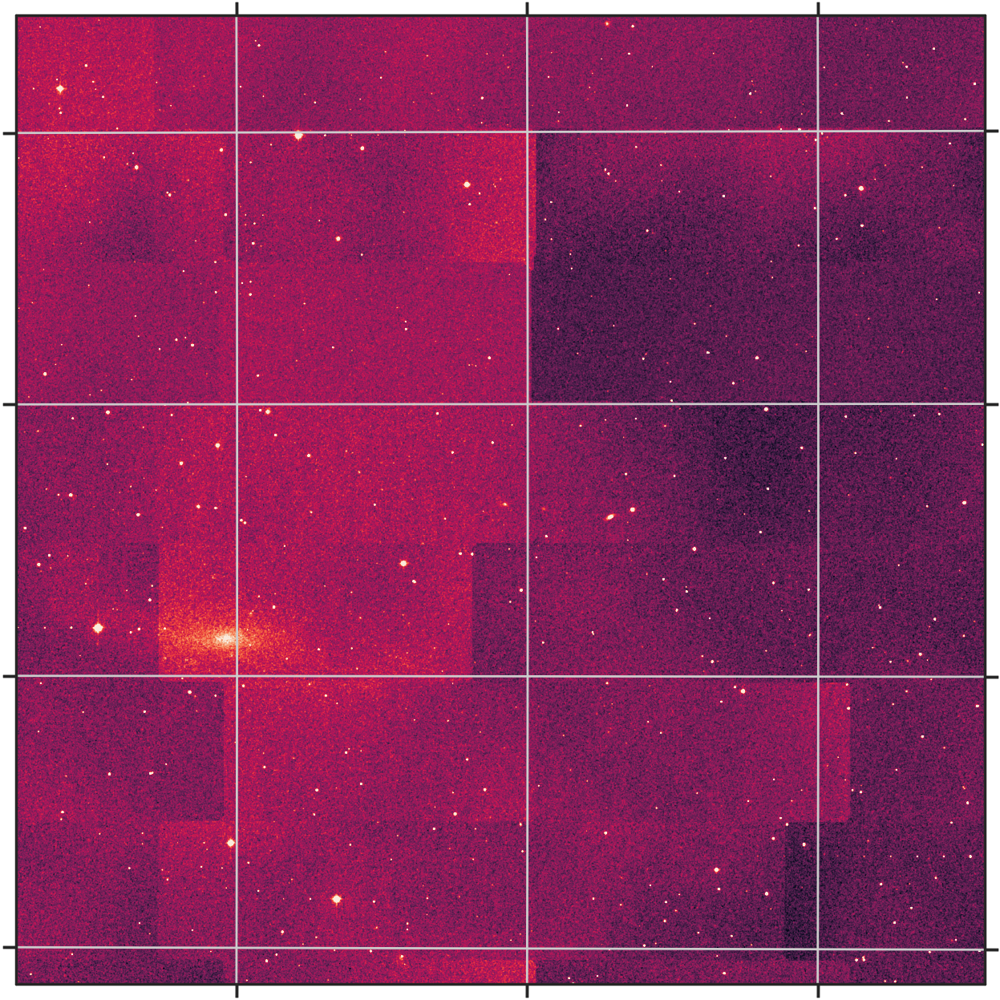

In [45]:
sns.set_theme(style='ticks',font_scale=1)
fig, ax = plt.subplots(figsize=(8,8),subplot_kw={'projection':wcs_H2},dpi=200)
ax.imshow(array, origin='lower', vmin=vmin, vmax=vmax)
ax.grid()
#plot_image(array,ax=ax,cmap='viridis',scale='linear', vmin=vmin,vmax=vmax)

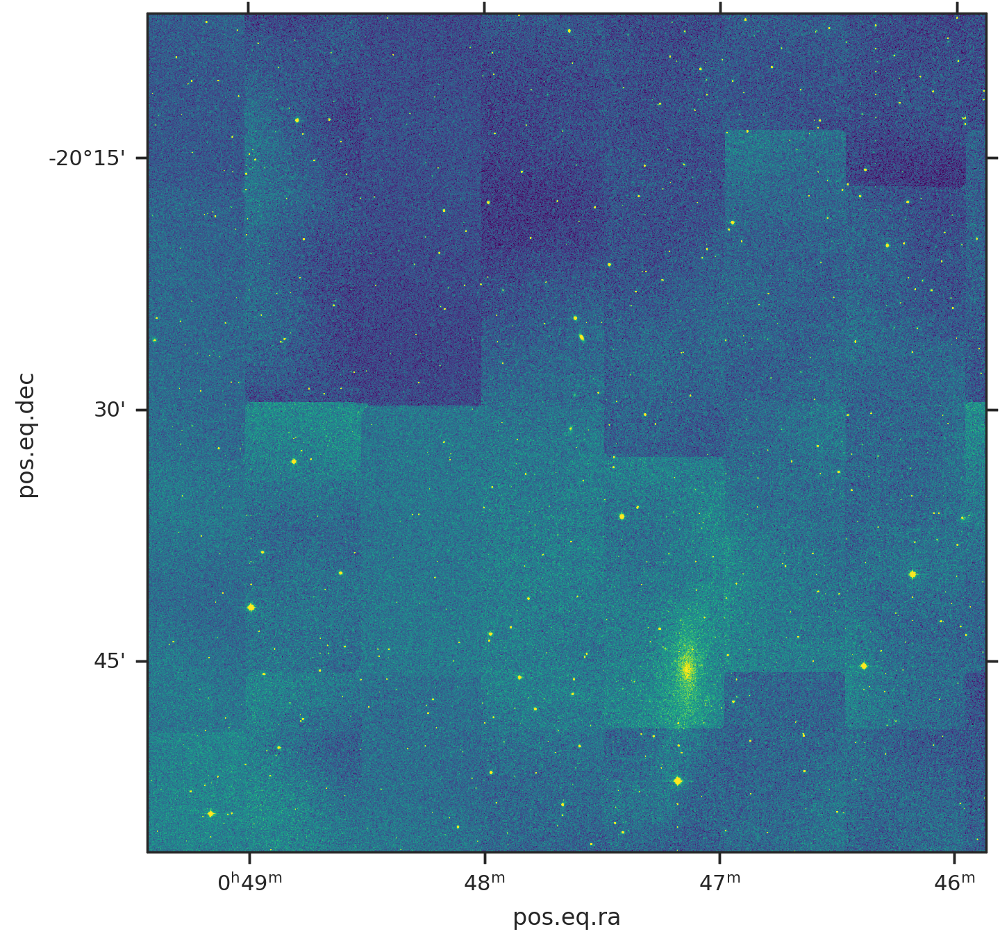

In [46]:
sns.set_theme(style='ticks',font_scale=1)
fig, ax = plt.subplots(figsize=(8,8),subplot_kw={'projection':wcs_H},dpi=200)
plot_image(image.data,ax=ax,cmap='viridis',scale='linear', vmin=vmin,vmax=vmax)

In [47]:
wcs_H = wcs_H2

In [50]:
import regions
offset_hawki = 112.5*u.arcsecond
chip1_center_true = 3.75/2*u.arcminute + 15*u.arcsecond #This is the distance to Chip 1 center from Field center.
field_hw = 7.5*u.arcminute #full field height width
chip1_hw = 3.5*u.arcminute #chip1 field height width

Hawki_center_coord = SkyCoord(ra_tar*u.deg-offset_hawki, 
                              dec_tar*u.deg-offset_hawki, unit='deg')
chip1_center_coord = SkyCoord(Hawki_center_coord.ra + chip1_center_true,
                              Hawki_center_coord.dec + chip1_center_true, unit='deg')

chip1_r = regions.RectangleSkyRegion(chip1_center_coord, width=chip1_hw, height=chip1_hw)
Hawki_r = regions.RectangleSkyRegion(Hawki_center_coord, width=field_hw, height=field_hw)

Hawki_pixel_region = Hawki_r.to_pixel(wcs_H)
chip1_pixel_region = chip1_r.to_pixel(wcs_H)

In [51]:
Hawki_center_coord.to_string('hmsdms')

'00h47m31.44s -20d33m16.9596s'

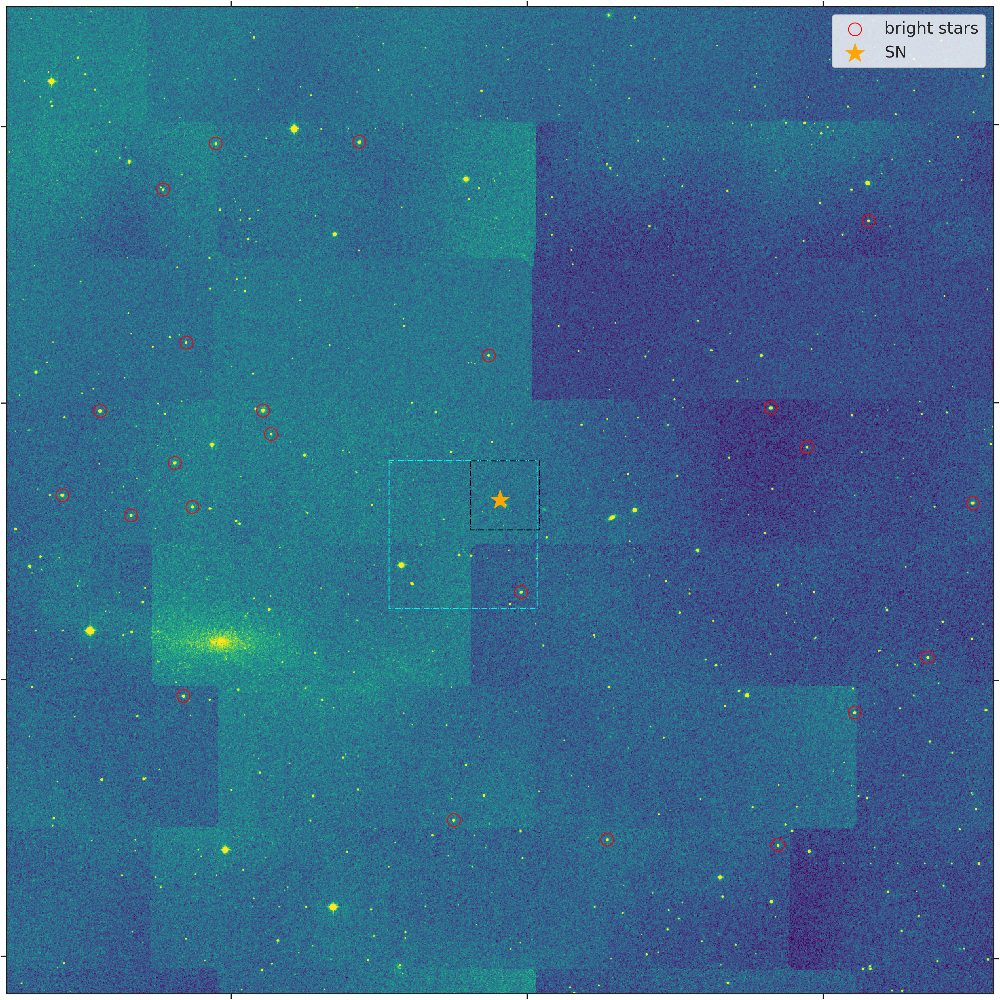

In [53]:
sns.set_theme(style='ticks',font_scale=2.5)
fig, ax = plt.subplots(figsize=(20,20),subplot_kw={'projection':wcs_H},dpi=200)

Hawki_pixel_region.plot(ax=ax,edgecolor='cyan',linestyle='-.',label='HAWK-I')
chip1_pixel_region.plot(ax=ax,edgecolor='black',linestyle='-.',label='chip1')

#plot_image(image.data,ax=ax,cmap='viridis',scale='linear', vmin=vmin,vmax=vmax)#percentile=[90,98])#vmin=10,vmax=1000)
plot_image(array,ax=ax,cmap='viridis',scale='linear', vmin=vmin,vmax=vmax)#percentile=[90,98])#vmin=10,vmax=1000)
#ax.scatter(ref['ra'],ref['decl'],color='grey',alpha=0.5)
#ax.scatter(ref_pix[0],ref_pix[1],color='grey',alpha=0.5)
mask = ref['H_mag'] <= 12.0
ref_pix_masked = wcs_H.all_world2pix(ref['ra'][mask],ref['decl'][mask],0)
ax.scatter(ref_pix_masked[0],ref_pix_masked[1],
           facecolors='none', edgecolors='red',zorder=5,alpha=3.0,marker='o',s=200, label='bright stars')

corners_pix = wcs_H.all_world2pix(corners[:,0]*u.deg,corners[:,1]*u.deg,0)
#ax.scatter(corners_pix[0],corners_pix[1],s=300, color='cyan')

tar_pix = wcs_H.all_world2pix(ra_tar,dec_tar,0)
ax.scatter(tar_pix[0],tar_pix[1],marker='*',s=450,label='SN',color='orange')

chip1_pix = wcs_H.all_world2pix(chip1[:,0],chip1[:,1],0)
#ax.scatter(chip1_pix[0],chip1_pix[1],label='chip1',s=100)

#cornersPix

#RectanglePixelRegion


#xy,w,h = get_xy_width_height(chip1_pix[0],chip1_pix[1])
#ax.add_patch(patches.Rectangle(xy,w,h,
#                               edgecolor='black',facecolor='None',linestyle='-.',
#                               linewidth=3.0,label='chip1',zorder=5))
#
#ax.add_patch(patches.Rectangle((corners_pix[0][3],corners_pix[1][3]),
#                               corners_pix[0][1]-corners_pix[0][2],
#                               corners_pix[1][2]-corners_pix[1][0],
#                               zorder=4,edgecolor='cyan',facecolor='None',linestyle='-.',
#                               linewidth=3.0,label='HAWK-I'))

#ax.scatter(ref['ra'][mask],ref['decl'][mask],color='red',zorder=5)
#ax.scatter(corners[:,0]*u.deg,corners[:,1]*u.deg,label='corners',s=100)
#ax.scatter(chip1[:,0]*u.deg,chip1[:,1]*u.deg,label='chip1',s=100)
#ax.scatter(ra_tar,dec_tar,marker='*',s=150,label='SN')
ax.legend(fontsize=18)
#ax.set_ylabel('Dec')
#ax.set_xlabel('Ra')
#ax.grid(color='white')

In [116]:
import regions
center = SkyCoord(ra,dec)
center

<SkyCoord (ICRS): (ra, dec) in deg
    (335.5882259, 19.81002564)>

4.0